# Visualizing and Clustering Gene Expression Trends

## Preliminaries

In this tutorial, you will learn how to:

- compute and visualize gene expression trends along specific differentiation trajectories. 
- cluster expression trends to detect genes with similar dynamical patterns. 

This tutorial notebook can be downloaded using the following [link](https://github.com/theislab/cellrank_notebooks/blob/main/tutorials/estimators/800_gene_trends.ipynb).

<img src="../_static/img/800_expression trends.jpg" width=1000  alt="CellRank fits Generalized Additive Models to recover continious gene expression dynamics along specific trajectories. ">

:::{note}

If you want to run this on your own data, you will need:

- a scRNA-seq dataset for which you computed a cell-cell transition matrix using any CellRank {mod}`kernel <cellrank.kernels>`. For each kernel, there exist individual tutorials that teach you how to use them. For example, we have tutorials about using {doc}`RNA velocity <../kernels/200_rna_velocity>`, {doc}`experimental time points <../kernels/500_real_time>`, and {doc}`pseudotime <../kernels/300_pseudotime>`, among others, to derive cell-cell transition probabilities. 
- any pseudotime computed on your data. We'll use the [Palantir pseudotime](https://github.com/dpeerlab/Palantir) in our example {cite}`setty:19`.
- imputed gene expression data. We'll use [MAGIC](https://github.com/KrishnaswamyLab/MAGIC) here, but you can use any imputation strategy that works for your data {cite}`vandijk:18`. 

:::

:::{note}

If you encounter any bugs in the code, our if you have suggestions for new features, please open an [issue](https://github.com/theislab/cellrank/issues/new/choose). If you have a general question or something you would like to discuss with us, please post on the [scverse discourse](https://discourse.scverse.org/c/ecosytem/cellrank/40). You can also contact us using info@cellrank.org.  

:::

### Import packages & data

In [1]:
import sys

if "google.colab" in sys.modules:
    !pip install -q git+https://github.com/theislab/cellrank

In [2]:
import numpy as np
import pandas as pd

import cellrank as cr
import scanpy as sc
import scvelo as scv

scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")
cr.settings.verbosity = 2
sc.settings.set_figure_params(frameon=False, dpi=100)

Global seed set to 0


In [3]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)

To demonstrate the appproach in this tutorial, we will use a scRNA-seq dataset of pancreas development at embyonic day E15.5 {cite}`bastidas-ponce:19`. We used this dataset in our {doc}`CellRank meets RNA velocity tutorial <../kernels/200_rna_velocity>` to compute a cell-cell transition matrix using the {class}`~cellrank.kernels.VelocityKernel`; this tutorial builds on the transition matrix computed there. The dataset including the transition matrix can be conveniently acessed through {mod}`~cellrank.datasets.pancreas_preprocessed_vk` {cite}`bastidas-ponce:19, bergen:20`.

In [4]:
adata = cr.datasets.pancreas_preprocessed_vk()

Additional MAGIC imputed expression for this data example is available on [Figshare](https://ndownloader.figshare.com/files/25120526?private_link=7e192d9821165855eaff0). See the [MAGIC documentation](https://krishnaswamylab.org/projects/magic) or CellRank's [reproducibility repo](https://github.com/theislab/cellrank_reproducibility/blob/master/notebooks/fig_5_benchmarking/palantir/ML_2021-10-26_palantir.ipynb) for more info.  

In [5]:
magic_imputed_data = pd.read_csv(
    "../datasets/pancreas_magic_imputed_data.csv", index_col=0
)

# filter to those genes for which we have imputed expression values
mask = np.in1d(adata.var_names, magic_imputed_data.columns)
adata = adata[:, mask].copy()

# add imputed data to an extra layer in AnnData
adata.layers["magic_imputed_data"] = magic_imputed_data[adata.var_names].loc[
    adata.obs_names
]

Reconstruct a {class}`~cellrank.kernels.VelocityKernel` from the {class}`~anndata.AnnData` object. 

In [6]:
vk = cr.kernels.VelocityKernel.from_adata(adata, key="T_fwd")
vk

VelocityKernel[n=2531, model='deterministic', similarity='correlation', softmax_scale=4.013]

:::{note}

The method {meth}`~cellrank.kernels.VelocityKernel.from_adata` allows you to reconstruct a CellRank kernel from an {class}`~anndata.AnnData` object. When you use a kernel to compute a transition matrix, this matrix, as well as a few informations about the computation, are written to the underlying {class}`anndata.AnnData` object upon calling {meth}`~cellrank.kernels.VelocityKernel.write_to_adata`. This makes it easy to write and read kernels from disk via the associated {class}`~anndata.AnnData` object. 

:::

### Compute terminal states and fate probabilities

We need to infer or assign terminal states and compute fate probabilities before we can visualize gene expression trends. 

:::{seealso}

To learn more about {attr}`initial <cellrank.estimators.GPCCA.initial_states>` and {attr}`terminal <cellrank.estimators.GPCCA.terminal_states>` state identification, see {doc}`600_initial_terminal`. To learn more about the computation of {attr}`~cellrank.estimators.GPCCA.fate_probabilities`, see {doc}`700_fate_probabilities`. 

:::

In [7]:
g = cr.estimators.GPCCA(vk)
print(g)

GPCCA[kernel=VelocityKernel[n=2531], initial_states=None, terminal_states=None]


Fit the {mod}`estimator <cellrank.estimators>` to obtain {attr}`~cellrank.estimators.GPCCA.macrostates`, declare {attr}`~cellrank.estimators.GPCCA.terminal_states`, and compute {attr}`~cellrank.estimators.GPCCA.fate_probabilities`. 

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[5, 10]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Computing `11` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:30)
Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`
Computing fate probabilities


  0%|          | 0/4 [00:00<?, ?/s]

Adding `adata.obsm['lineages_fwd']`
       `.fate_probabilities`
    Finish (0:00:00)


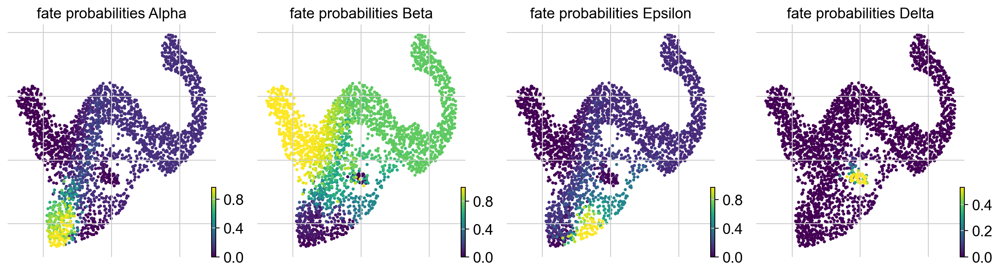

In [8]:
# compute macrostates
g.fit(cluster_key="clusters", n_states=11)

# declare terminal states
g.set_terminal_states(states=["Alpha", "Beta", "Epsilon", "Delta"])

# compute and visualize fate probabilities
g.compute_fate_probabilities()
g.plot_fate_probabilities(same_plot=False)

## Visualize gene expression trends

### Prepare for trend plotting

To visualize gene expression trends, we fit [Generalized Additive Models (GAMs)](https://en.wikipedia.org/wiki/Generalized_additive_model) to MAGIC-imputed gene expression data, ordering cells in pseudotime, and weighting each cell's contribution to each trajectory according to fate probabilities. While we will be using the [Palantir pseudotime](https://github.com/dpeerlab/Palantir) here, you can use whatever pseudotime works best for your data, including {func}`Diffusion Pseudotime (DPT) <scanpy.tl.dpt>`. Let's start by visulizing the Palantir pseudotime. 

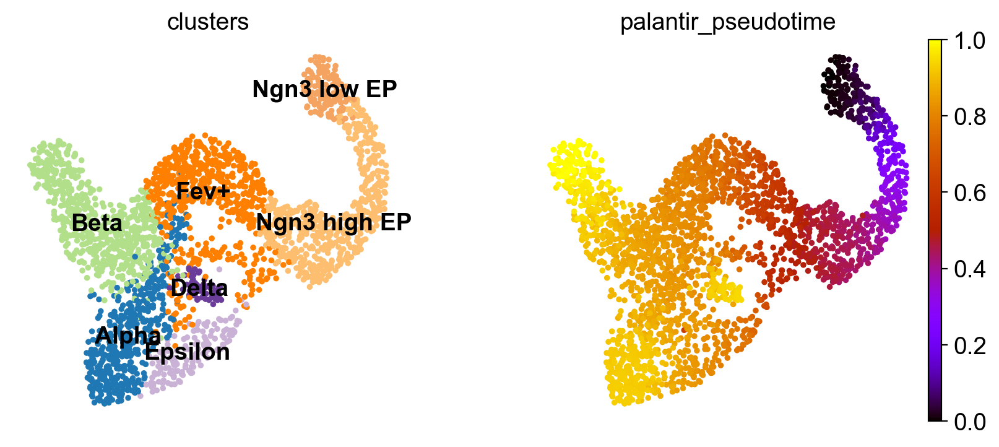

In [9]:
sc.pl.embedding(
    adata,
    basis="umap",
    color=["clusters", "palantir_pseudotime"],
    color_map="gnuplot",
    legend_loc="on data",
)

This looks promising, the pseudotime increases continiously from early states (Ngn3 low EP) until late states (Alpha, Beta, Delta, Epsilon). We can make this more quantitative, without relying on the 2D UMAP, by showing the distribution of pseudotime values per cluster. 

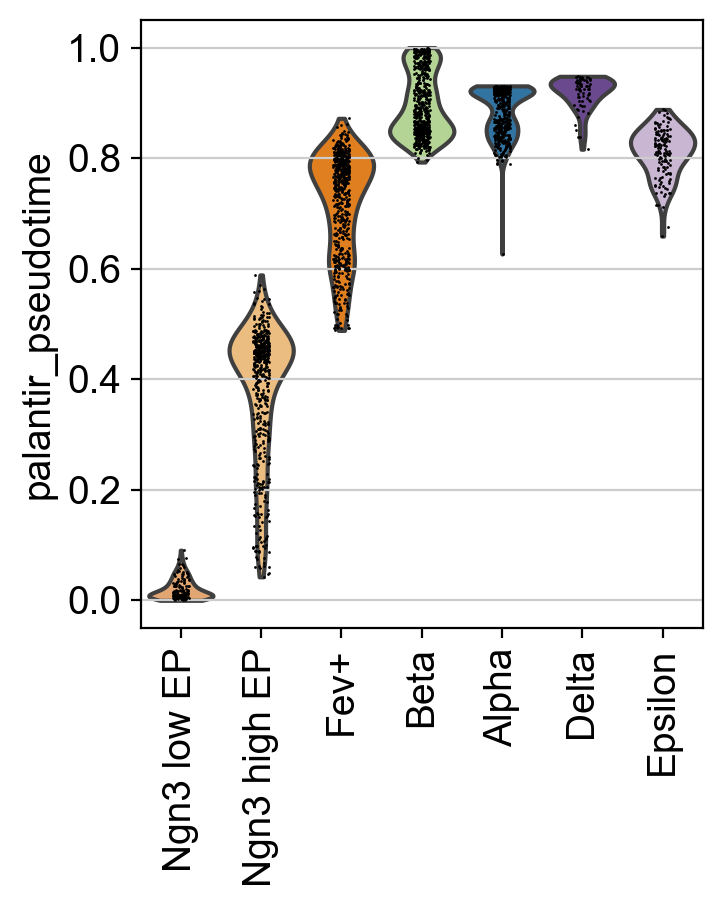

In [10]:
sc.pl.violin(adata, keys=["palantir_pseudotime"], groupby="clusters", rotation=90)

This confirms what we saw in the UMAP. 

### Visualize expression trends via line plots

The first step in gene trend plotting is to initialite a {mod}`model <cellrank.models>` for GAM fitting. 

In [11]:
model = cr.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)

:::{note}

CellRank supports two packages for GAM-fitting: [pyGAM](https://pygam.readthedocs.io/en/latest/index.html) (in Python) and [mgcv](https://cran.r-project.org/web/packages/mgcv/index.html) (in R). For us, mgcv usually yields better results, but is a bit harder to get to include in a Python-based workflow as you have to use [rpy2](https://rpy2.github.io/). 

:::

Next, we specify the pseudotime via the `time_key`, the data layer via the `data_key`, the gene set via `genes`, and a few other parameters for plotting. See the {func}`API <cellrank.pl.gene_trends>` for a full description.  

Computing trends using `1` core(s)


  0%|          | 0/4 [00:00<?, ?gene/s]

    Finish (0:00:00)
Plotting trends


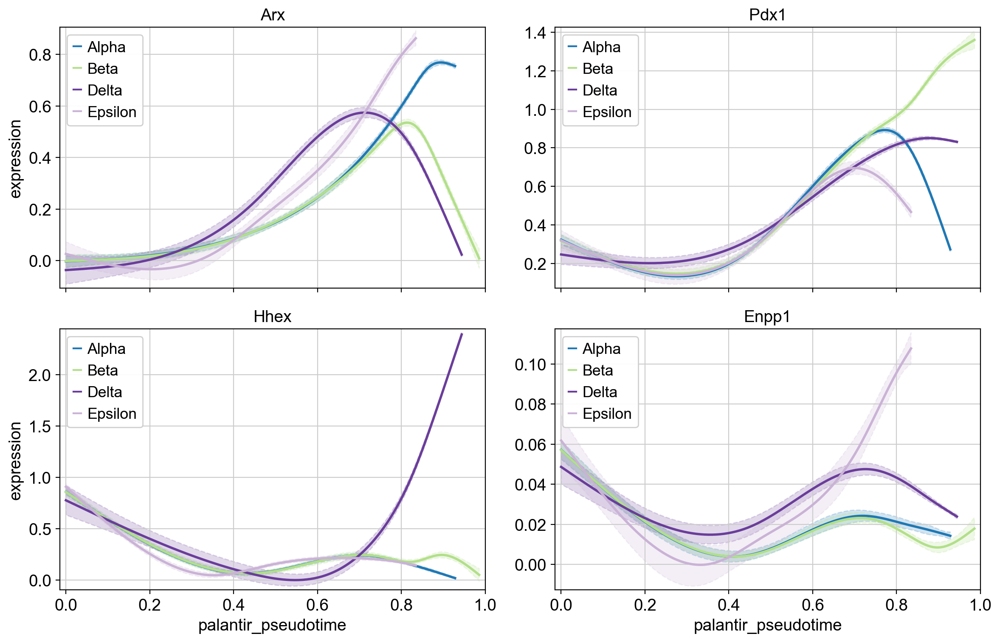

In [12]:
cr.pl.gene_trends(
    adata,
    model=model,
    data_key="magic_imputed_data",
    genes=["Arx", "Pdx1", "Hhex", "Enpp1"],
    same_plot=True,
    ncols=2,
    time_key="palantir_pseudotime",
    hide_cells=True,
    weight_threshold=(1e-3, 1e-3),
)

Above, we highlight the trajectory-specific dynamics of a few TFs, some of which have known functions in pancreatic fate specification. For example, *Hhex* and *Arx* are involved in Delta and Alpha cell generation, respectively {cite}`zhang:14, wilcox:13`. 

### Visualize expression cascades via heatmaps

In this section, we focus on just one trajectory and visualize the temporal activation of several genes along this trajectory. As an example, let's take the Beta trajectory. We computed {meth}`putative driver genes <cellrank.estimators.GPCCA.compute_lineage_drivers>` for this trajectory in the {doc}`700_fate_probabilities` tutorial, here, we explore their temporal activation cascade. To do this, as before, we fit the expression of putative Beta-driver genes along the pseudotime using GAMs, weighting each cell's contribution according to Beta {attr}`~cellrank.estimators.GPCCA.fate_probabilities`. 

Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:00)
Computing trends using `1` core(s)


  0%|          | 0/40 [00:00<?, ?gene/s]

    Finish (0:00:01)


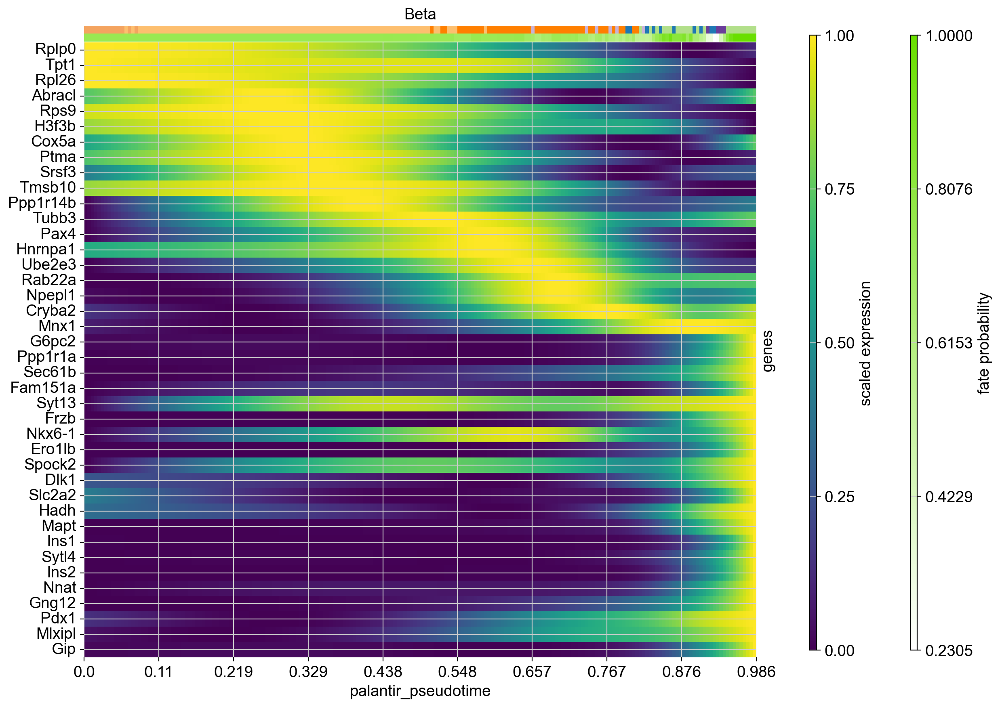

In [13]:
# compute putative drivers for the Beta trajectory
beta_drivers = g.compute_lineage_drivers(lineages="Beta")

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages="Beta",
    cluster_key="clusters",
    show_fate_probabilities=True,
    data_key="magic_imputed_data",
    genes=beta_drivers.head(40).index,
    time_key="palantir_pseudotime",
    figsize=(12, 10),
    show_all_genes=True,
    weight_threshold=(1e-3, 1e-3),
)

Each row in this heatmap corresponds to one gene, sorted according to their expression peak in pseudotime. We show cluster annotations, and the fate probabilities used to determine each cells's contribution to the Beta trajectory, at the top. 

Our analysis suggests the following temporal activation of TFs with known function in Beta-cell fate choice: *TPT1* (also called *TCTP*) {cite}`tsai:14, diraison:11` peaks early, followed by *Pax4* {cite}`napolitano:15, sosa:97` and *Mnx1* {cite}`dalgin:12, pan:15`. As expected, *Ins1* and *Ins2* peak late, and so do *Gng12* {cite}`byrnes:18` and *Pdx1* {cite}`moin:19, zhu:21, bastidas:17`. 

Beyond genes with a previously documented role in Beta cell fate choice, this analysis also pinpoints putative new drivers, including the early-peaking TFs *Ptma* and *Srsf3*. 

## Cluster gene expression trends

### Compute clustering

To identify genes with similar expression patterns, CellRank can {func}`cluster expression trends <cellrank.pl.cluster_trends>`. Importantly, we do this again in a trajectory-specific fashion, i.e. we only consider GAM-fitted expression trends towards Beta cells and cluster these. We only consider highly-variable genes here to speed up the computation. 

Computing trends using `8` core(s)


  0%|          | 0/1996 [00:00<?, ?gene/s]

Global seed set to 0
Global seed set to 0
Global seed set to 0
Global seed set to 0
Global seed set to 0
Global seed set to 0
Global seed set to 0
Global seed set to 0


    Finish (0:02:11)
Saving data to `adata.uns['lineage_Beta_trend']`


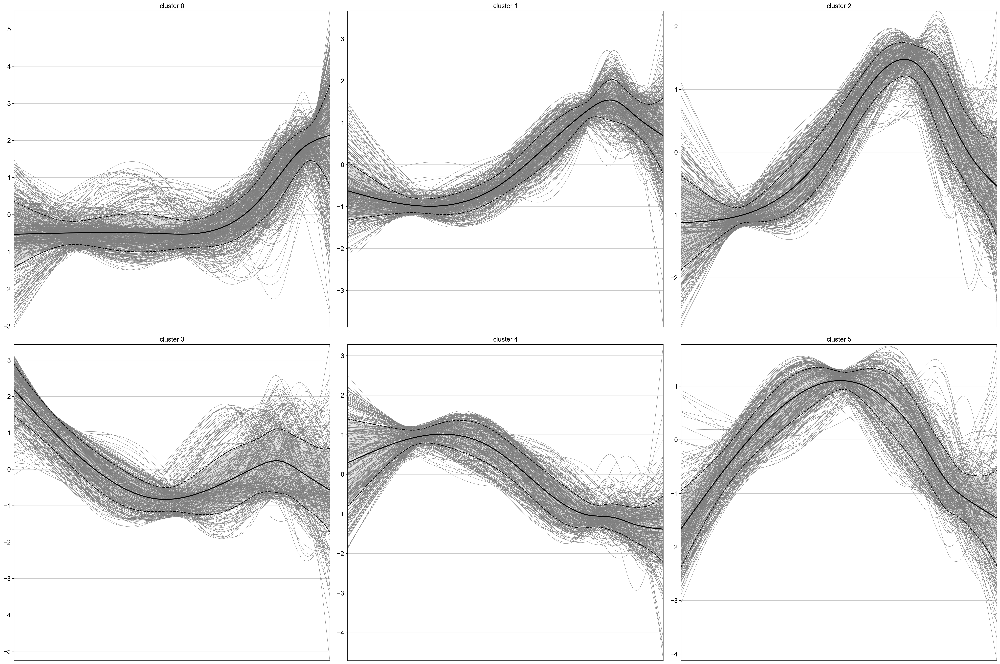

In [14]:
cr.pl.cluster_trends(
    adata,
    model=model,  # use the model from before
    lineage="Beta",
    data_key="magic_imputed_data",
    genes=adata[:, adata.var["highly_variable"]].var_names,
    time_key="palantir_pseudotime",
    weight_threshold=(1e-3, 1e-3),
    n_jobs=8,
    random_state=0,
    clustering_kwargs={"resolution": 0.2, "random_state": 0},
    neighbors_kwargs={"random_state": 0},
)

The results are written to {attr}`~anndata.AnnData.uns`, conveniently as an {class}`~anndata.AnnData` object, where genes now take the role of the observations. 

In [15]:
gdata = adata.uns["lineage_Beta_trend"].copy()
gdata

AnnData object with n_obs × n_vars = 1996 × 200
    obs: 'clusters'
    var: 'x_test'
    uns: 'pca', 'neighbors', 'leiden'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

Let's merge some gene annotations from the original {class}`~anndata.AnnData` object. 

In [16]:
cols = ["means", "dispersions"]
gdata.obs = gdata.obs.merge(
    right=adata.var[cols], how="left", left_index=True, right_index=True
)
gdata

AnnData object with n_obs × n_vars = 1996 × 200
    obs: 'clusters', 'means', 'dispersions'
    var: 'x_test'
    uns: 'pca', 'neighbors', 'leiden'
    obsm: 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

### Analzye gene clusters

We have a gene-level PCA and k-NN graph - let's use that to compute and plot a gene-level UMAP embedding. 

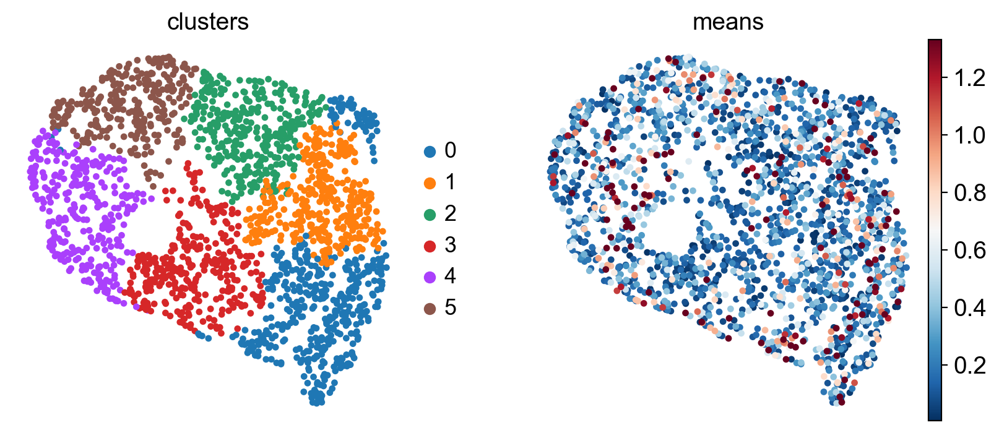

In [17]:
sc.tl.umap(gdata, random_state=0)

sc.pl.embedding(gdata, basis="umap", color=["clusters", "means"], vmax="p95")

Each dot represent a gene, colored by expression trend clusters along the Beta trajectory (left) or the mean expression across cells (right). Let's highlight a few driver genes we discussed above. 

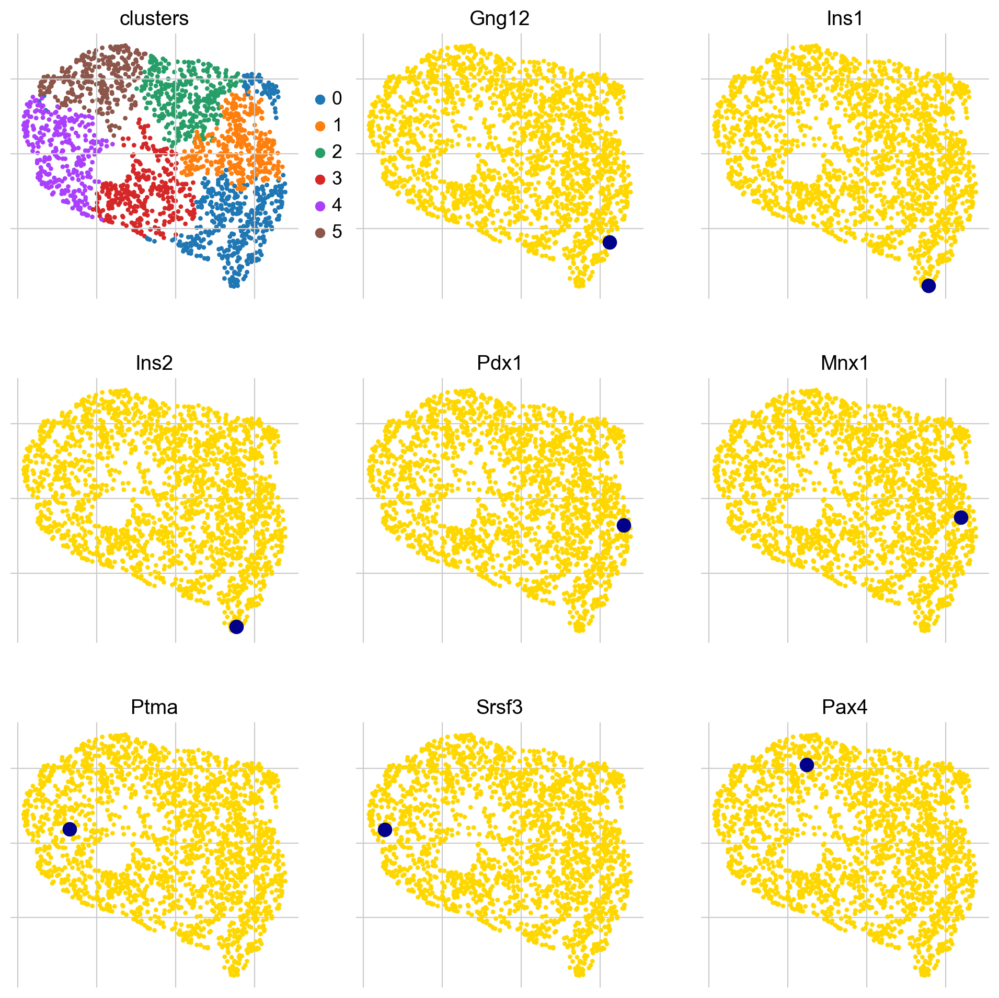

In [18]:
genes = ["Gng12", "Ins1", "Ins2", "Pdx1", "Mnx1", "Ptma", "Srsf3", "Pax4"]

# make sure the genes were included in the cluster analysis
mask = np.array([gene in gdata.obs_names for gene in genes])

if not mask.all():
    print(f"Could not find {np.array(genes)[~mask]}")

# subset to the genes that are present
genes = list(np.array(genes)[mask])

# retrieve their indices for plotting
indices = [np.where(np.in1d(gdata.obs_names, gene))[0][0] for gene in genes]
title = ["clusters"] + genes

scv.pl.scatter(
    gdata, c=["clusters"] + indices, title=title, ncols=3, legend_loc="right"
)

Many of the late-peaking TFs we discussed when plotting the heatmap, including *Gng12*, *Ins1*, *Ins2* and and *Pdx1*, are assigned to cluster 0, which is indeed a late-peaking cluster. We can confirm this by checking in the `gdata` object. 

In [19]:
gdata[genes].obs

,clusters,means,dispersions
Gng12,0,0.878893,1.414954
Ins1,0,2.744454,5.726741
Ins2,0,2.016665,4.514492
Pdx1,0,0.990023,1.193838
Mnx1,1,0.295992,0.935342
Ptma,4,2.462189,1.153156
Srsf3,4,1.438808,0.470357
Pax4,5,0.794812,1.326806


*Pax4* is assigned to the intermediate-peak cluster 5, we can now query for genes that have similar expression dynamics along the Beta trajectory by looking at genes from the same cluster. 

Computing trends using `1` core(s)


  0%|          | 0/9 [00:00<?, ?gene/s]

    Finish (0:00:00)
Plotting trends


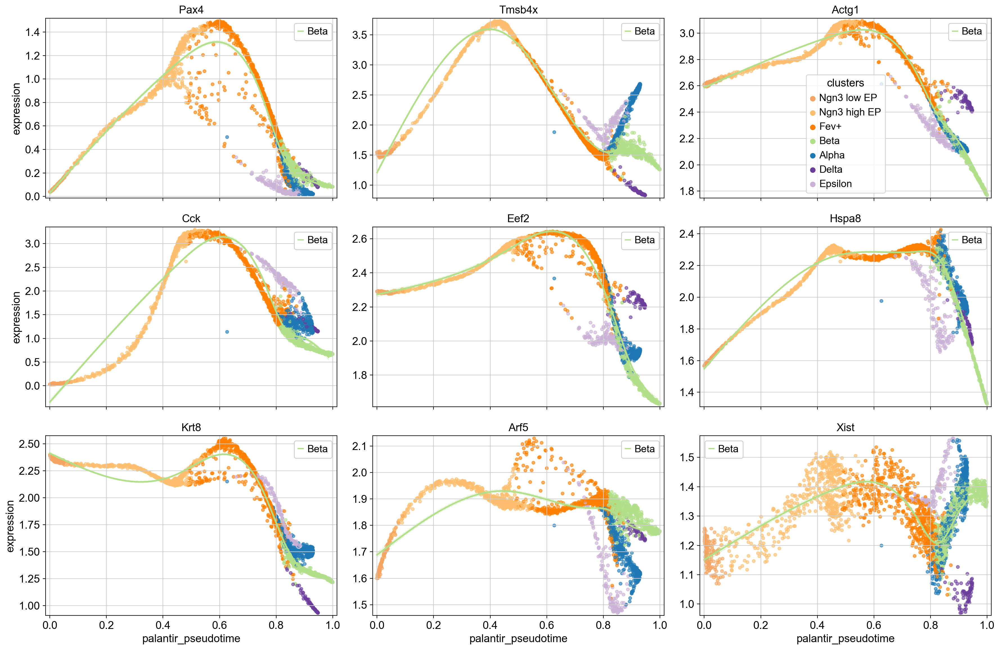

In [20]:
# obtain some genes from the same cluster, sort by mean expression
mid_peak_genes = (
    gdata[gdata.obs["clusters"] == "5"]
    .obs.sort_values("means", ascending=False)
    .head(8)
    .index
)

# plot
cr.pl.gene_trends(
    adata,
    model=model,
    lineages="Beta",
    cell_color="clusters",
    data_key="magic_imputed_data",
    genes=["Pax4"] + list(mid_peak_genes),
    same_plot=True,
    ncols=3,
    time_key="palantir_pseudotime",
    hide_cells=False,
    weight_threshold=(1e-3, 1e-3),
)

To showcase the flexibility of this plotting function, we're only drawing the trends towards Beta, and we visualize cells, colored by their cluster assignment. This serves as an example of how {func}`gene trend clustering <cellrank.pl.cluster_trends>` can be used to identify genes that show similar expression dynamics to a known {meth}`driver gene <cellrank.estimators.GPCCA.compute_lineage_drivers>` of a given lineage. 

## Closing matters

### What's next? 

In this tutorial, you learned how to visualize trajectory-specific gene expression trends via {func}`line plots <cellrank.pl.gene_trends>` or {fund}`heatmaps <cellrank.pl.heatmap>`, and how to {func}`cluster them <cellrank.pl.cluster_trends>`. For the next steps, we recommend to:

- explore this with cell-transitions derived from another {mod}`kernel <cellrank.kernels>`. The advantage of CellRank is that you can run the exact same computations from above, no matter what data modality you used to obtain your cell-cell transition matrix. 
- take a look at the {class}`API <cellrank.estimators.GPCCA>` to learn about parameters you can use to adapt these computations to your data. 
- try this out on your own data. 

### Package versions

In [21]:
cr.logging.print_versions()

cellrank==1.5.2.dev206+ga2748bea scanpy==1.9.3 anndata==0.8.0 numpy==1.24.2 numba==0.57.0rc1 scipy==1.10.1 pandas==1.5.3 pygpcca==1.0.4 scikit-learn==1.1.3 statsmodels==0.13.5 python-igraph==0.10.4 scvelo==0.3.0 pygam==0.8.0 matplotlib==3.7.0 seaborn==0.12.2
